# TFOD Faster RCNN with InceptionResnet

In [1]:
from tensorflow.compat.v1 import ConfigProto
from tensorflow.compat.v1 import InteractiveSession

config = ConfigProto()
config.gpu_options.allow_growth = True
session = InteractiveSession(config=config)

## Download Dataset

In [2]:
!curl -L "https://public.roboflow.com/ds/F9SwI9aQ4q?key=POgQfDZ4Al" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

Streaming output truncated to the last 5000 lines.
 extracting: export/1478899927636379684_jpg.rf.aa1ddaeb16d8fbbc1d923e1b04836fed.jpg  
 extracting: export/1478897095754019307_jpg.rf.aa1b8183dcaef29a615c9912089c3473.jpg  
 extracting: export/1478900676026204617_jpg.rf.aa1a8e8719bef56f09a0d6dd90f3f3ea.jpg  
 extracting: export/1478896569024419960_jpg.rf.aa13cd4baea5f463689bcf0ae7cbaecd.jpg  
 extracting: export/1478900208139809310_jpg.rf.aa22f718963fd74816c36362747a2e5f.jpg  
 extracting: export/1478732946050736131_jpg.rf.aa22a65179976732a06a4f60a276f9a2.jpg  
 extracting: export/1478732798092393026_jpg.rf.aa228f5791738d87d1bacf62531c0cda.jpg  
 extracting: export/1478901018229397554_jpg.rf.aa234b2c992ac279bcbdf1456c9d8162.jpg  
 extracting: export/1478896275952367309_jpg.rf.aa23b59b1d8d54f3a09132da9e8c2a6c.jpg  
 extracting: export/1478895537846002041_jpg.rf.aa2ba452c9c3f91284b08e87f1144c37.jpg  
 extracting: export/1478901473546608423_jpg.rf.aa261619fcf6bfccf9da09aa1b0757fc.jpg  
 ex

## Load the Annotations

In [3]:
import pandas as pd
import os

In [4]:
dataset_path = 'export'

In [5]:
annotations = pd.read_csv(dataset_path + '/_annotations.csv')

In [6]:
annotations.head()

,filename,width,height,class,xmin,ymin,xmax,ymax
0,1478020642210920002_jpg.rf.0020e318772012f5778...,512,512,car,119,238,148,256
1,1478020642210920002_jpg.rf.0020e318772012f5778...,512,512,car,195,236,209,255
2,1478020642210920002_jpg.rf.0020e318772012f5778...,512,512,car,205,241,213,257
3,1478020642210920002_jpg.rf.0020e318772012f5778...,512,512,car,213,236,224,258
4,1478020642210920002_jpg.rf.0020e318772012f5778...,512,512,car,303,243,323,258


In [7]:
annotations = annotations.set_index('filename')

## Get the images

In [8]:
images = [f for f in os.listdir(dataset_path) if '.jpg' in f]

In [9]:
len(images)

15000

In [10]:
train_test_ratio = 0.9
train_test_limit = int(train_test_ratio * len(images))
train_image_names = images[:train_test_limit]
test_image_names = images[train_test_limit:]

In [11]:
print(len(train_image_names))
print(len(test_image_names))

13500
1500


## Create Label Map

In [12]:
labels = annotations['class'].unique()

In [13]:
labels

array(['car', 'pedestrian', 'trafficLight-GreenLeft',
       'trafficLight-Green', 'trafficLight-Red', 'trafficLight-RedLeft',
       'trafficLight', 'truck', 'biker', 'trafficLight-Yellow',
       'trafficLight-YellowLeft'], dtype=object)

In [14]:
def create_label_map():
    with open('label_map.pbtxt', 'w') as f:
        for i, l in enumerate(labels):
            f.write(
                'item {\n'+
                '    id: {}\n'.format(i+1)+
                '    name: \'{}\'\n'.format(l)+
                '}\n\n'
            )

create_label_map()

## Install TFOD

In [15]:
import os
import pathlib

# Clone the tensorflow models repository if it doesn't already exist
if "models" in pathlib.Path.cwd().parts:
  while "models" in pathlib.Path.cwd().parts:
    os.chdir('..')
elif not pathlib.Path('models').exists():
  !git clone --depth 1 https://github.com/tensorflow/models

In [16]:
# Install the Object Detection API
%%bash
cd models/research/
protoc object_detection/protos/*.proto --python_out=.
cp object_detection/packages/tf2/setup.py .
python -m pip install .

Processing /content/models/research
  Created wheel for object-detection: filename=object_detection-0.1-cp36-none-any.whl size=1608663 sha256=981335f1b0a1598595d11a4be5531d0ae47375795fa520308258b2fb943e0981
  Stored in directory: /tmp/pip-ephem-wheel-cache-7887t33w/wheels/94/49/4b/39b051683087a22ef7e80ec52152a27249d1a644ccf4e442ea
Successfully built object-detection
  Found existing installation: object-detection 0.1
    Uninstalling object-detection-0.1:
      Successfully uninstalled object-detection-0.1


## Generate TFRecords

In [17]:
from object_detection.utils import label_map_util
from object_detection.utils import dataset_util
from PIL import Image as pil_image
import io
import tensorflow as tf

In [18]:
label_map = label_map_util.load_labelmap('label_map.pbtxt')
label_map_dict = label_map_util.get_label_map_dict(label_map)

In [19]:
label_map_dict

{'biker': 9,
 'car': 1,
 'pedestrian': 2,
 'trafficLight': 7,
 'trafficLight-Green': 4,
 'trafficLight-GreenLeft': 3,
 'trafficLight-Red': 5,
 'trafficLight-RedLeft': 6,
 'trafficLight-Yellow': 10,
 'trafficLight-YellowLeft': 11,
 'truck': 8}

In [20]:
def create_tfrecords(image_names, record_name):
    writer = tf.io.TFRecordWriter(record_name)
    
    for image_name in image_names:
        if image_name not in annotations.index:
            continue
        image_path = os.path.join(dataset_path, image_name)
        with open(image_path, 'rb') as fid:
            encoded_jpg = fid.read()
        img_opened = pil_image.open(image_path)
        width, height = img_opened.size
        filename = image_path.encode('utf8')
        image_format = b'jpg'

        img_annot_details = annotations.loc[image_name]
        if type(img_annot_details['class']) is str:
            xmins = [img_annot_details['xmin']]
            ymins = [img_annot_details['ymin']]
            xmaxs = [img_annot_details['xmax']]
            ymaxs = [img_annot_details['ymax']]
            labels = [img_annot_details['class']]
        else:
            xmins = img_annot_details['xmin'].tolist()
            ymins = img_annot_details['ymin'].tolist()
            xmaxs = img_annot_details['xmax'].tolist()
            ymaxs = img_annot_details['ymax'].tolist()
            labels = img_annot_details['class'].tolist()
        classes = [label_map_dict[c] for c in labels]
        labels = [l.encode('utf8') for l in labels]

        example = tf.train.Example(features=tf.train.Features(feature={
            'image/height': dataset_util.int64_feature(height),
            'image/width': dataset_util.int64_feature(width),
            'image/filename': dataset_util.bytes_feature(filename),
            'image/source_id': dataset_util.bytes_feature(filename),
            'image/encoded': dataset_util.bytes_feature(encoded_jpg),
            'image/format': dataset_util.bytes_feature(image_format),
            'image/object/bbox/xmin': dataset_util.float_list_feature(xmins),
            'image/object/bbox/xmax': dataset_util.float_list_feature(xmaxs),
            'image/object/bbox/ymin': dataset_util.float_list_feature(ymins),
            'image/object/bbox/ymax': dataset_util.float_list_feature(ymaxs),
            'image/object/class/text': dataset_util.bytes_list_feature(labels),
            'image/object/class/label': dataset_util.int64_list_feature(classes),
        }))

        
        writer.write(example.SerializeToString())
        
    writer.close()

In [21]:
create_tfrecords(train_image_names, 'train.record')

In [22]:
create_tfrecords(test_image_names, 'test.record')

## Get a Pre-trained Model

In [23]:
!curl -L download.tensorflow.org/models/object_detection/tf2/20200711/faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8.tar.gz > faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8.tar.gz; tar -xvf faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8.tar.gz; rm faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8.tar.gz;

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  423M  100  423M    0     0   256M      0  0:00:01  0:00:01 --:--:--  256M
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/checkpoint/
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/checkpoint/ckpt-0.data-00000-of-00001
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/checkpoint/checkpoint
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/checkpoint/ckpt-0.index
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/saved_model/
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/saved_model/saved_model.pb
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/saved_model/variables/
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/saved_model/variables/variables.data-00000-of-00001
faste

## Configure a Training Pipeline

In [24]:
%%bash
mkdir my_training
cp faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config my_training/

mkdir: cannot create directory ‘my_training’: File exists


## Training

In [30]:
!cp models/research/object_detection/model_main_tf2.py .

In [32]:
!python model_main_tf2.py --model_dir=my_training --pipeline_config_path=my_training/pipeline.config

^C


In [33]:
%load_ext tensorboard

In [34]:
%tensorboard --logdir my_training

<IPython.core.display.Javascript object>

## Inference

In [81]:
from PIL import Image
from six import BytesIO
import numpy as np
import matplotlib.pyplot as plt
from object_detection.utils import config_util
from object_detection.builders import model_builder
from object_detection.utils import visualization_utils as viz_utils

In [88]:
%matplotlib inline

In [65]:
model_dir = 'my_training'
pipeline_location = 'my_training/pipeline.config'
configs = config_util.get_configs_from_pipeline_file(pipeline_location)
model_config = configs['model']
detection_model = model_builder.build(model_config=model_config, is_training=False)

In [66]:
ckpt = tf.train.Checkpoint(model=detection_model)
ckpt.restore('my_training/ckpt-5')

In [67]:
def get_model_detection_function(model):
  """Get a tf.function for detection."""

  @tf.function
  def detect_fn(image):
    """Detect objects in image."""

    image, shapes = model.preprocess(image)
    prediction_dict = model.predict(image, shapes)
    detections = model.postprocess(prediction_dict, shapes)

    return detections, prediction_dict, tf.reshape(shapes, [-1])

  return detect_fn

detect_fn = get_model_detection_function(detection_model)

In [68]:
#map labels for inference decoding
label_map_path = configs['eval_input_config'].label_map_path
label_map = label_map_util.load_labelmap(label_map_path)
categories = label_map_util.convert_label_map_to_categories(
    label_map,
    max_num_classes=label_map_util.get_max_label_map_index(label_map),
    use_display_name=True)
category_index = label_map_util.create_category_index(categories)
label_map_dict = label_map_util.get_label_map_dict(label_map, use_display_name=True)

In [73]:
def load_image_into_numpy_array(path):
  """Load an image from file into a numpy array.

  Puts image into numpy array to feed into tensorflow graph.
  Note that by convention we put it into a numpy array with shape
  (height, width, channels), where channels=3 for RGB.

  Args:
    path: the file path to the image

  Returns:
    uint8 numpy array with shape (img_height, img_width, 3)
  """
  img_data = tf.io.gfile.GFile(path, 'rb').read()
  image = Image.open(BytesIO(img_data))
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape((im_height, im_width, 3)).astype(np.uint8)

In [70]:
test_image_names[0]

'1478020543199589178_jpg.rf.d6b68263d1c87a17a68324e72b3a2599.jpg'

In [108]:
image_np = load_image_into_numpy_array(os.path.join('export', test_image_names[100]))

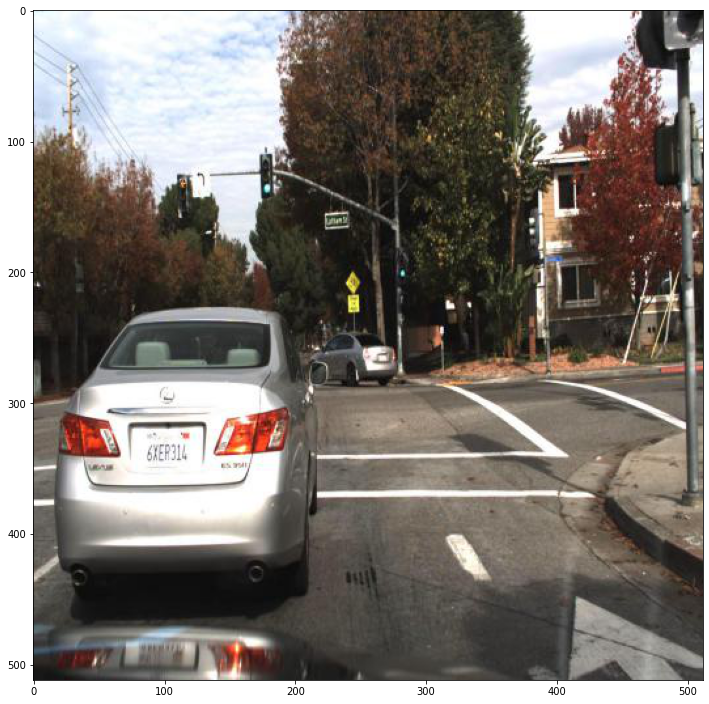

In [109]:
plt.figure(figsize=(12,16))
plt.imshow(image_np)
plt.show()

In [110]:
input_tensor = tf.convert_to_tensor(np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

In [111]:
detections['detection_scores'][0].numpy()

array([1.7020713e-21, 1.0778446e-21, 9.7282711e-22, 1.0930984e-22,
       9.1508950e-23, 2.8530066e-24, 1.0280730e-24, 3.4138446e-25,
       2.6341934e-25, 2.2130406e-25, 1.4162236e-26, 9.8400660e-27,
       8.7161526e-27, 3.7668898e-27, 2.7419374e-27, 2.4390085e-27,
       1.8343023e-27, 1.7871962e-27, 1.0735982e-27, 2.4742143e-28,
       1.6262731e-28, 1.5846180e-28, 1.4289532e-28, 1.1645262e-28,
       9.7572618e-29, 9.5019750e-29, 8.3089162e-29, 1.9478564e-29,
       3.6570107e-30, 2.3849150e-30, 2.1877197e-30, 2.0240203e-30,
       1.6747872e-30, 1.4700772e-30, 1.3717061e-30, 1.2766894e-30,
       1.1411736e-30, 1.0879439e-30, 6.1758334e-31, 4.6606611e-31,
       4.5772509e-31, 3.5884518e-31, 3.1862339e-31, 3.1758949e-31,
       2.4776393e-31, 2.0062390e-31, 1.9951724e-31, 1.8580743e-31,
       1.7668833e-31, 1.1839960e-31, 8.1435645e-32, 6.5532300e-32,
       4.2732573e-32, 3.6972645e-32, 3.6561701e-32, 3.4706626e-32,
       3.3586504e-32, 2.9020164e-32, 2.7379691e-32, 2.3426237e

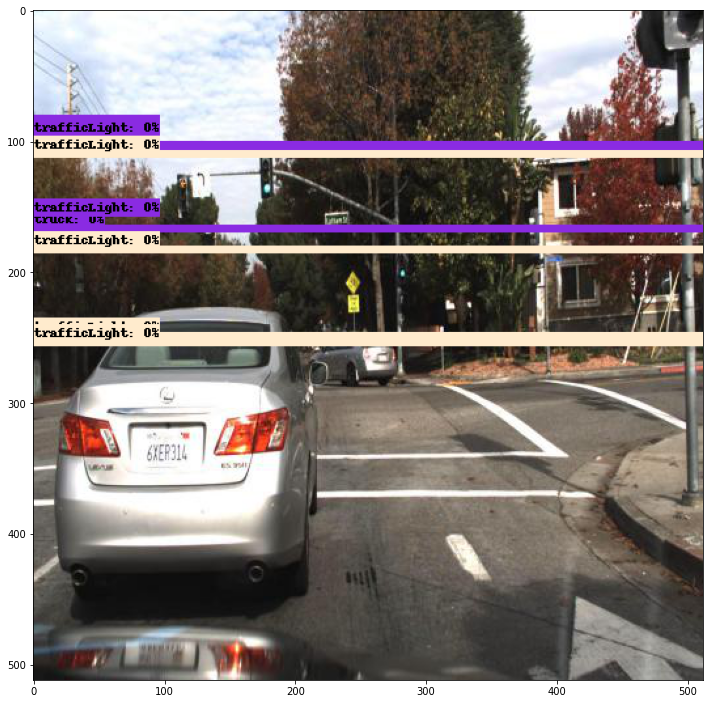

In [114]:
label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=1e-25,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)
plt.show()

## Model Export

In [39]:
%%bash

mkdir testing
cp models/research/object_detection/exporter_main_v2.py testing/

In [49]:
%cd /content/testing

/content/testing


In [50]:
!pwd

/content/testing


In [60]:
!python exporter_main_v2.py --input_type image_tensor --pipeline_config_path ..\my_training\pipeline.config --trained_checkpoint_dir ..\my_training\ --output_directory rcnn_inception_resnet_trained\

2021-01-15 08:36:13.162190: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
FATAL Flags parsing error: flag --output_directory=None: Flag --output_directory must have a value other than None.
Pass --helpshort or --helpfull to see help on flags.
